In [1]:
import sys
sys.path.insert(0, '/Users/samart/Desktop/Neuro/SNNs/CompBrainLoihi/nengo_loihi')

import nengo
import numpy as np
import matplotlib.pyplot as plt

### Synapses

In [12]:
net = nengo.Network()
with net:
    # Create an input signal that alternates between -1 and 1
    # plus some random noise
    def noisy_input(t):
        return np.sin(2*np.pi*t) + 0.2*np.random.randn()
    
    stim = nengo.Node(noisy_input)
    stim_probe = nengo.Probe(stim, synapse=0.01)
    # Create three ensembles to compare different synaptic time constants
    fast = nengo.Ensemble(100, 1, label='fast')
    medium = nengo.Ensemble(100, 1, label='medium')
    slow = nengo.Ensemble(100, 1, label='slow')
    fast_probe = nengo.Probe(fast, synapse=0.01)
    slow_probe = nengo.Probe(slow, synapse=0.01)
    medium_probe = nengo.Probe(medium, synapse=0.01)
    
    # Connect with different synaptic time constants
    nengo.Connection(stim, fast, synapse=0.001)    # Very fast, but noisy
    nengo.Connection(stim, medium, synapse=0.01)   # Balanced
    nengo.Connection(stim, slow, synapse=0.1)      # Smooth but delayed

In [13]:
with nengo.Simulator(net) as sim:
    sim.run(1.0)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

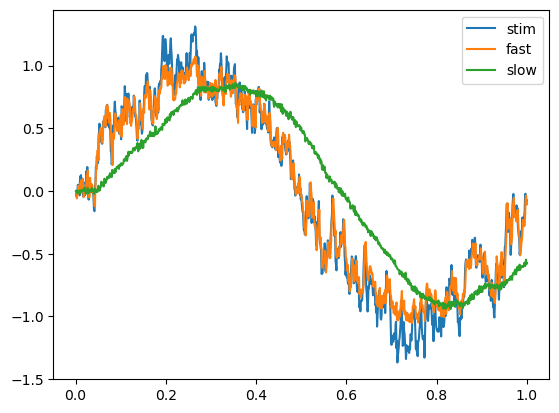

In [14]:
plt.plot(sim.trange(), sim.data[stim_probe].T[0], label='stim')
plt.plot(sim.trange(), sim.data[fast_probe].T[0], label='fast')
plt.plot(sim.trange(), sim.data[slow_probe].T[0], label='slow')
#plt.plot(sim.trange(), sim.data[medium_probe].T[0], label='medium')
plt.legend()
plt.show()

## Decoders and Solvers

In [64]:
N = 40
k = 2

In [65]:
solver = nengo.solvers.Lstsq(weights=True)

In [66]:
#isinstance(nengo.RegularSpiking(nengo.RectifiedLinear()), nengo.neurons.NeuronType)

def generate_encoders(N, k, rad=1.0, method='ScatteredHypersphere'):
    intercepts = nengo.dists.Uniform(-1.0, 0.9)
    match method.lower():
        case m if "hypersphere" in m:
            dist = nengo.dists.ScatteredHypersphere(surface=True)
            encoders = dist.sample(N,k)
        case "gaussian":
            encoders = np.random.randn(N, k)
    return(intercepts, encoders)

Ia, Ea = generate_encoders(N, k)
Ib, Eb = generate_encoders(N, k)

Ea.shape

(40, 2)

In [67]:
net = nengo.Network()
with net:
    stim = nengo.Node(np.array([1.2, -2.0]))
    stim_p = nengo.Probe(stim)
    
    A = nengo.Ensemble(n_neurons=N, dimensions=k, label='A', 
            neuron_type=nengo.RegularSpiking(nengo.RectifiedLinear()),
            encoders=Ea)#, gain=np.diag(np.ones(N)), bias=np.zeros(N))
    A_p = nengo.Probe(A)
    A_neurons = nengo.Probe(A.neurons)
    #("decoded_output", "input", "scaled_encoders")
    
    B = nengo.Ensemble(n_neurons=N, dimensions=k, label='B',
                       encoders=Eb)
    B_p = nengo.Probe(B)
    B_neurons = nengo.Probe(B.neurons)
    B_input = nengo.Probe(B, 'input')

    nengo.Connection(stim, A, synapse=0.05)
    conn = nengo.Connection(A, B, solver=solver, synapse=0.05)
    conn_in_probe = nengo.Probe(conn, "input")
    conn_out_probe = nengo.Probe(conn, "output")

In [68]:
isinstance(A.neuron_type, nengo.neurons.NeuronType), isinstance(B.neuron_type, nengo.neurons.LIF)


(True, True)

In [69]:
with nengo.Simulator(net) as sim:
    # Get decoders and encoders
    
    # Compare with actual weights
    #W_actual = sim.data[conn].weights
    
    # They should be approximately equal
    sim.run(1.0)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

In [75]:
Wba = sim.data[conn].weights # n_post x n_pre
print(Wba.shape)
print(sim.data[A_neurons].shape)
print(sim.data[B_neurons].shape)
print(sim.data[B_input].shape)
print(Eb.shape)

conn.function is None

(40, 40)
(1000, 40)
(1000, 40)
(1000, 2)
(40, 2)


True

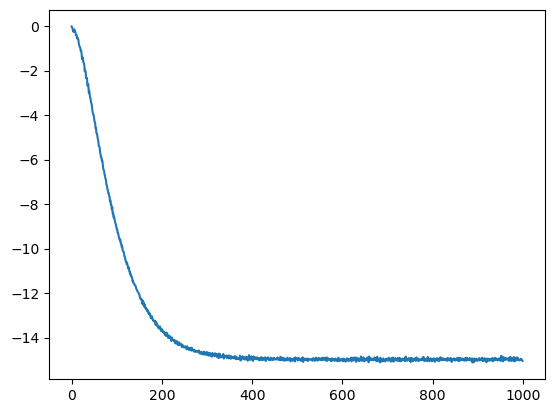

In [76]:
filtered_pre = conn.synapse.filt(sim.data[A_neurons])
predicted_input_to_b = (Wba @ filtered_pre.T).T

#print(np.allclose(sim.data[B_input], predicted_input_to_b, rtol=1e-3))

delta = predicted_input_to_b - (sim.data[B_input] @ Eb.T)
plt.plot(delta.mean(axis=1))

In [29]:
sim.data[A_output] == sim.data[A_p]

array([[ True,  True],
       [ True,  True],
       [ True,  True],
       ...,
       [ True,  True],
       [ True,  True],
       [ True,  True]])

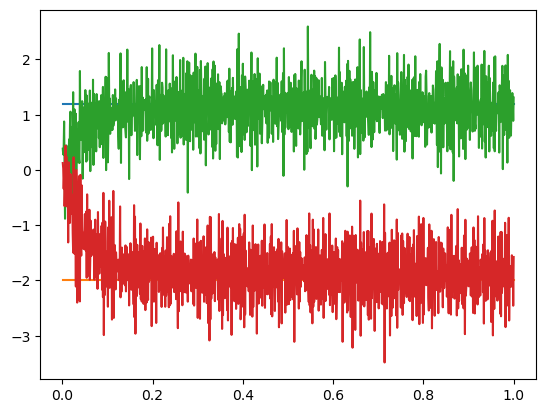

In [83]:
plt.plot(sim.trange(), sim.data[stim_p].T[0])
plt.plot(sim.trange(), sim.data[stim_p].T[1])
plt.plot(sim.trange(), sim.data[A_p].T[0])
plt.plot(sim.trange(), sim.data[A_p].T[1])
plt.show()

In [88]:
#plt.plot(sim.trange(), sim.data[A_p].T[0])
#plt.plot(sim.trange(), sim.data[A_p].T[1])
#plt.plot(sim.trange(), sim.data[B_input].T[1])
#plt.plot(sim.trange(), sim.data[stim_p].T[1])
sim.data[B_input]
sim.data[A_neurons].shape

(1000, 40)

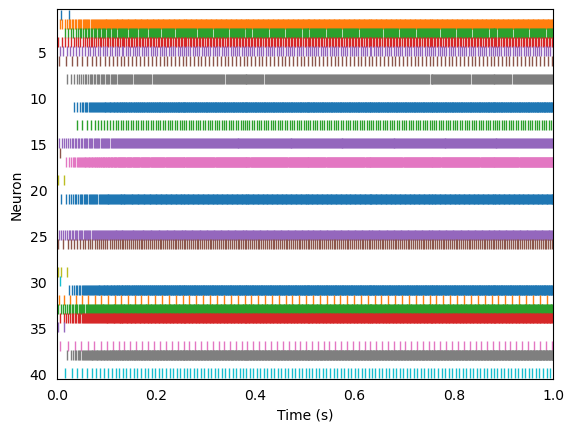

In [90]:
plot_spikes(sim.data[A_neurons])

In [89]:
from nengo.utils.matplotlib import rasterplot
def plot_spikes(spike_data):
    plt.figure()
    ax = plt.subplot(1, 1, 1)
    rasterplot(sim.trange(), spike_data, ax)
    ax.set_xlim(0, 1)
    ax.set_ylabel("Neuron")
    ax.set_xlabel("Time (s)")
    plt.show()

    

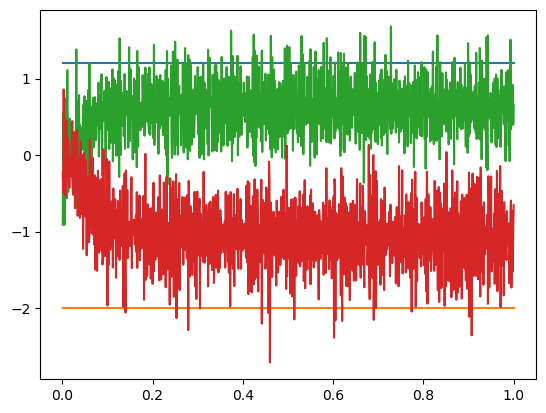

In [71]:
plt.plot(sim.trange(), sim.data[stim_p].T[0])
plt.plot(sim.trange(), sim.data[stim_p].T[1])
plt.plot(sim.trange(), sim.data[B_p].T[0])
plt.plot(sim.trange(), sim.data[B_p].T[1])
plt.show()

Animation size has reached 21009038 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


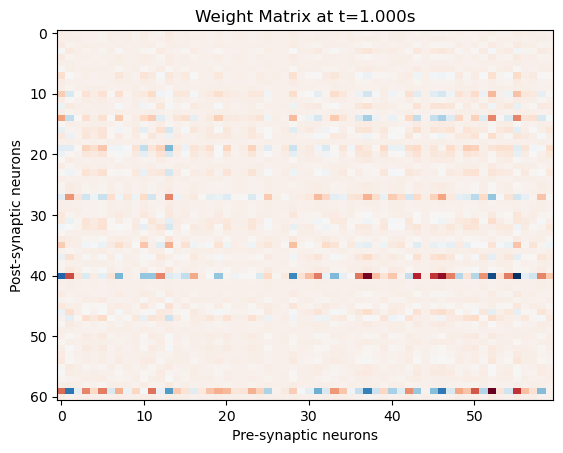

In [74]:
#plt.plot(sim.trange(), sim.data[weight_probe].T[0])
# show the weight matrix as an animated image, with the first dimension being the time
sim.data[weight_probe].shape   
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig, ax = plt.subplots()
data = sim.data[weight_probe]

def animate(frame):
    ax.clear()
    im = ax.imshow(data[frame], aspect='auto', cmap='RdBu_r')
    ax.set_title(f'Weight Matrix at t={sim.trange()[frame]:.3f}s')
    ax.set_xlabel('Pre-synaptic neurons')
    ax.set_ylabel('Post-synaptic neurons')
    return [im]

anim = FuncAnimation(fig, animate, frames=len(sim.trange()), interval=50)
HTML(anim.to_jshtml())

